In [1]:
import numpy as np
import pickle
import h5py
import matplotlib.pyplot as plt
import os
import seaborn as sns
import matplotlib as mpl
from matplotlib.lines import Line2D
import matplotlib.patches as patches
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib.animation import FuncAnimation
import matplotlib.patheffects as pe
import matplotlib
import scipy as sci
from IPython.display import HTML
from sklearn.metrics import mean_squared_error
from matplotlib.gridspec import GridSpec
import cmasher as cmr
import matplotlib.ticker as tck
mpl.rcParams['figure.dpi'] = 400
sns.set_theme()
plt.rcParams.update({'figure.max_open_warning': 0})

In [2]:
vmx_a=.7
vmn_a=.1
indir='/home/tsw35/soteria/neon_advanced/qaqc_data/'

In [3]:
def binplot1d(xx,yy,ani,xbins,anibins=np.array([-.05,.05,.15,.25,.35,.45,.55,.65,.75,.85]),mincnt=10):
    xplot=(xbins[0:-1]+xbins[1:])/2
    yplot=np.zeros((len(anibins)-1,len(xplot)))
    aniplot=(anibins[0:-1]+anibins[1:])/2
    for i in range(len(anibins)-1):
        for j in range(len(xbins)-1):
            pnts=yy[(ani>=anibins[i])&(ani<anibins[i+1])&(xx>=xbins[j])&(xx<xbins[j+1])]
            if len(pnts)<mincnt:
                yplot[i,j]=float('nan')
            else:
                yplot[i,j]=np.nanmedian(pnts)
    return xplot,yplot,aniplot

In [4]:
iva_colors_HEX = ["#410d00","#831901","#983e00","#b56601","#ab8437",
              "#b29f74","#7f816b","#587571","#596c72","#454f51"]
#Transform the HEX colors to RGB.
from PIL import ImageColor
iva_colors_RGB = np.zeros((np.size(iva_colors_HEX),3),dtype='int')
for i in range(0,np.size(iva_colors_HEX)):
    iva_colors_RGB[i,:] = ImageColor.getcolor(iva_colors_HEX[i], "RGB")
iva_colors_RGB = iva_colors_RGB[:,:]/(256)
colors = iva_colors_RGB.tolist()
#----------------------------------------------------
from matplotlib.colors import LinearSegmentedColormap,ListedColormap
inbetween_color_amount = 10
newcolvals = np.zeros(shape=(10 * (inbetween_color_amount) - (inbetween_color_amount - 1), 3))
newcolvals[0] = colors[0]
for i, (rgba1, rgba2) in enumerate(zip(colors[:-1], np.roll(colors, -1, axis=0)[:-1])):
    for j, (p1, p2) in enumerate(zip(rgba1, rgba2)):
        flow = np.linspace(p1, p2, (inbetween_color_amount + 1))
        # discard first 1 since we already have it from previous iteration
        flow = flow[1:]
        newcolvals[ i * (inbetween_color_amount) + 1 : (i + 1) * (inbetween_color_amount) + 1, j] = flow
newcolvals
cmap_ani = ListedColormap(newcolvals, name='from_list', N=None)

In [5]:
def cani_norm(x):
    try:
        x_=x.copy()
        x_[x_<vmn_a]=vmn_a
        x_[x_>vmx_a]=vmx_a
    except:
        x_=x.copy()
        if x_>vmx_a:
            x_=vmx_a
        elif x_<vmn_a:
            x_=vmn_a
    
    x_=(x_-vmn_a)/(vmx_a-vmn_a)
    return cmap_ani(x_)

In [6]:
d_unst=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_unst_v2.p','rb'))
d_stbl=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_stbl_v2.p','rb'))
d_ani_ust=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_ani_ust_v2.p','rb'))
d_ani_stb=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_ani_stb_v2.p','rb'))


# ANI/zL Distribution

In [61]:
fps=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_S_UVWT.h5','r')
fpu=h5py.File('/home/tsw35/soteria/neon_advanced/qaqc_data/NEON_TW_U_UVWT.h5','r')

lmost=fps['L_MOST'][:]
zzd=fps['tow_height'][:]-fps['zd'][:]
zL_s=zzd/lmost

lmost=fpu['L_MOST'][:]
zzd=fpu['tow_height'][:]-fpu['zd'][:]
zL_u=zzd/lmost

ani_u=fpu['ANI_YB'][:]
ani_s=fps['ANI_YB'][:]

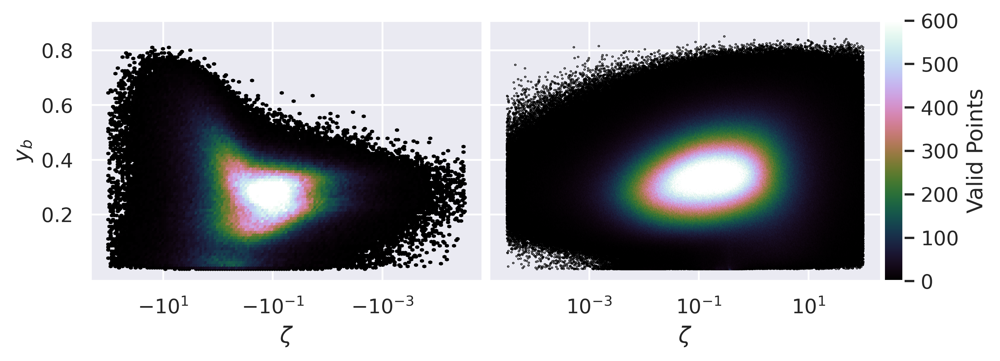

In [65]:
cmp='cubehelix'
mp=5
fig=plt.figure(figsize=(8,4))
grid=ImageGrid(fig, 111,  # similar to subplot(111)
                nrows_ncols=(1, 2),
                axes_pad=0.05,
                cbar_mode='single',
                cbar_location='right',
                cbar_pad=.02,
                cbar_size="5%")
im=grid[0].hexbin(np.log10(-zL_u),np.array(ani_u)*mp,mincnt=1,cmap=cmp,gridsize=150,extent=(-4.5,2,0,np.sqrt(3)/2*mp),vmin=0,vmax=600)
im=grid[1].hexbin(np.log10(zL_s),np.array(ani_s*mp),mincnt=1,cmap=cmp,gridsize=700,extent=(-4.5,2,0,np.sqrt(3)/2*mp),vmin=0,vmax=600)
#extent=(-4.5,2,0,.8)
#,extent=(10**(-4.5),10**2,0,np.sqrt(3)/2)

grid[0].set_yticks(np.array([.2,.4,.6,.8])*mp,[.2,.4,.6,.8])
grid[1].set_yticks(np.array([.2,.4,.6,.8])*mp,[.2,.4,.6,.8])
grid[1].set_xticks([-3,-1,1],[r'$10^{-3}$',r'$10^{-1}$',r'$10^{1}$'])
grid[0].set_xticks([-3,-1,1],[r'$-10^{-3}$',r'$-10^{-1}$',r'$-10^{1}$'])
grid[0].invert_xaxis()

grid[0].set_ylabel(r'$y_b$')

grid[0].set_xlabel(r'$\zeta$')
grid[1].set_xlabel(r'$\zeta$')

cb=grid.cbar_axes[0].colorbar(im,label='Valid Points')
#grid.cbar_axes[0].tick_params(labelsize=lbsize)
#cb.set_label(label=cbarlabel2,size=lbsize)

#fig.text(0.5, 0.04, r'$\zeta$', ha='center')
plt.savefig('images/img_2.png', bbox_inches = "tight")

# Median Bin Lines

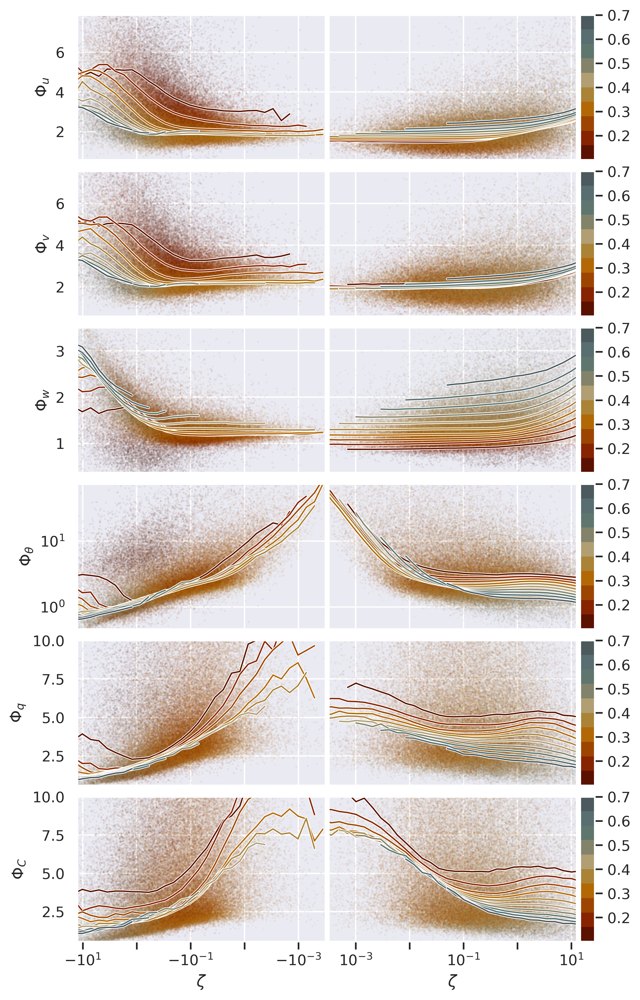

In [66]:
sz=1.4
fig,axs=plt.subplots(6,3,figsize=(5*sz,9*sz),gridspec_kw={'width_ratios': [1,1,.06]},dpi=400)
ss=.1
alph=.2
minpct=1e-04

anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

j=0
for v in d_unst.keys():
    # SETUP
    cc=cani_norm(d_unst[v]['ani'][:])
    cc_s=cani_norm(d_stbl[v]['ani'][:])
    phi=d_unst[v]['phi']
    phi_s=d_stbl[v]['phi']
    
    ymin=min(np.nanpercentile(phi,.1),np.nanpercentile(phi_s,.1))
    ymax=max(np.nanpercentile(phi,99),np.nanpercentile(phi_s,99))
    if v in ['H2O','CO2']:
        ymax=10
    
    ##### UNSTABLE #####
    # SCATTER UNSTABLE
    axs[j,0].scatter(-d_unst[v]['zL'][:],phi,color=cc,s=ss,alpha=alph,marker=".")
    
    # LINES UNSTABLE
    xplt=d_unst[v]['p_zL']
    yplt=d_unst[v]['p_phi']
    cnt=d_unst[v]['p_cnt']
    tot=np.sum(cnt)
    yplt[cnt/tot<minpct]=float('nan')
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,0].semilogx(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,0].loglog(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    
    # LABELING
    if j==5:
        axs[j,0].tick_params(which="both", bottom=True)
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,0].xaxis.set_minor_locator(locmin)
        axs[j,0].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
        axs[j,0].set_xlabel(r'$\zeta$')
    else:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    #axs[j,0].xaxis.set_minor_locator(tck.AutoMinorLocator())
    axs[j,0].set_ylabel(ylabels[j])
    axs[j,0].set_ylim(ymin,ymax)
    axs[j,0].invert_xaxis()
    
    ##### STABLE #####
    # SCATTER STABLE
    axs[j,1].scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph,marker=".")
    
    # LINES STABLE
    xplt=d_stbl[v]['p_zL']
    yplt=d_stbl[v]['p_phi']
    cnt=d_stbl[v]['p_cnt']
    tot=np.sum(cnt)
    yplt[cnt/tot<minpct]=float('nan')
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,1].semilogx(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,1].loglog(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    
    # LABELING
    if j==5:
        axs[j,1].tick_params(which="both", bottom=True)
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$10^{-3}$','',r'$10^{-1}$','',r'$10^{1}$'])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
        axs[j,1].set_xlabel(r'$\zeta$')
    else:
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    axs[j,1].tick_params(labelleft=False)
    #axs[j,1].grid(False)
    #axs[j,1].xaxis.grid(True, which='minor')
    axs[j,1].set_ylim(ymin,ymax)
    
    
    #### COLORBAR ####
    axs[j,2].imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
    axs[j,2].set_xticks([],[])
    inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
    inta.extend(anilvl)
    inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
    xtc=np.interp([.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
    axs[j,2].set_yticks(xtc,[.2,.3,.4,.5,.6,.7])
    axs[j,2].grid(False)
    #plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
    axs[j,2].yaxis.tick_right()
    
    j=j+1

plt.subplots_adjust(hspace=.08,wspace=.02)
#fig.text(0.5, 0.04, r'$\zeta$', ha='center')
plt.savefig('images/img_3.png', bbox_inches = "tight")

# STP Fit Lines

In [9]:
anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

In [10]:
zL_u=-np.logspace(-4,2,40)
zL=zL_u.copy()
zL=zL.reshape(1,40).repeat(10,0)

ani=anilvl.copy()
ani=ani.reshape(10,1).repeat(40,1)

# U Unstable
a=.784-2.582*np.log10(ani)
u_u_stp=a*(1-3*zL)**(1/3)
u_u_old=2.55*(1-3*zL)**(1/3)

# V Unstable
a=.725-2.702*np.log10(ani)
v_u_stp=a*(1-3*zL)**(1/3)
v_u_old=2.05*(1-3*zL)**(1/3)

# W Unstable 
a=1.119-0.019*ani-.065*ani**2+0.028*ani**3
w_u_stp=a*(1-3*zL)**(1/3)
w_u_old=1.35*(1-3*zL)**(1/3)
#print(a)

# T Unstable
a=0.017+0.217*ani
t_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
t_u_old=.99*(.067-zL)**(-1/3)
t_u_old[zL>-0.05]=.015*(-zL[zL>-0.05])**(-1)+1.76

# elif var=='H2Ou':
#        return np.sqrt(30)*(1-25*zL)**(-1/3)
#    elif var=='CO2u':
#        return np.sqrt(30)*(1-25*zL)**(-1/3)


# H2O Unstable 
a=0.017+0.217*ani
h_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
h_u_old=np.sqrt(30)*(1-25*zL)**(-1/3)

# CO2 Unstable
a=0.017+0.217*ani
c_u_stp=1.07*(0.05+np.abs(zL))**(-1/3)+\
        (-1.14+a*(np.abs(zL)**(-9/10)))*(1-np.tanh(10*(np.abs(zL))**(2/3)))
c_u_old=np.sqrt(30)*(1-25*zL)**(-1/3)

############### STABLE ##################
zL_s=np.logspace(-4,2,40)
zL=zL_s.copy()
zL=zL.reshape(1,40).repeat(10,0)

# U Stable
a_=np.array([2.332,-2.047,2.672])
c_=np.array([.255,-1.76,5.6,-6.8,2.65])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
u_s_stp=a*(1+3*zL)**(c)
u_s_old=2.06*np.ones(zL.shape)

# V Stable
a_=np.array([2.385,-2.781,3.771])
c_=np.array([.654,-6.282,21.975,-31.634,16.251])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
v_s_stp=a*(1+3*zL)**(c)
v_s_old=2.06*np.ones(zL.shape)


# W Stable
a_=np.array([.953,.188,2.243])
c_=np.array([.208,-1.935,6.183,-7.485,3.077])
a=0
c=0
for i in range(3):
    a=a+a_[i]*ani**i
for i in range(5):
    c=c+c_[i]*ani**i
w_s_stp=a*(1+3*zL)**(c)
w_s_old=1.6*np.ones(zL.shape)

# T Stable
a_=[.607,-.754]
b_=[-.353,3.374,-8.544,6.297]
c_=[0.195,-1.857,5.042,-3.874]
d_=[.0763,-1.004,2.836,-2.53]
#d_=[.0763,-.1004,-2.836,-2.53]
a=0
b=0
c=0
d=0
for i in range(2):
    a=a+a_[i]*ani**i
for i in range(4):
    b=b+b_[i]*ani**i
    c=c+c_[i]*ani**i
    d=d+d_[i]*ani**i
    
logphi=a+b*np.log10(zL)+c*np.log10(zL)**2+d*np.log10(zL)**3
#logphi=a+b*np.log10(zL)+c*np.log10(zL**2)+d*np.log10(zL**3)
t_s_stp=10**(logphi)
#t_s_stp=np.sqrt(10**(logphi))
t_s_old=0.00087*(zL)**(-1.4)+2.03

h_s_stp=t_s_stp
c_s_stp=t_s_stp
h_s_old=2.74*np.ones(zL.shape)
c_s_old=2.74*np.ones(zL.shape)

ust_stp=[u_u_stp,v_u_stp,w_u_stp,t_u_stp,h_u_stp,c_u_stp]
stb_stp=[u_s_stp,v_s_stp,w_s_stp,t_s_stp,h_s_stp,c_s_stp]
ust_old=[u_u_old,v_u_old,w_u_old,t_u_old,h_u_old,c_u_old]
stb_old=[u_s_old,v_s_old,w_s_old,t_s_old,h_s_old,c_s_old]

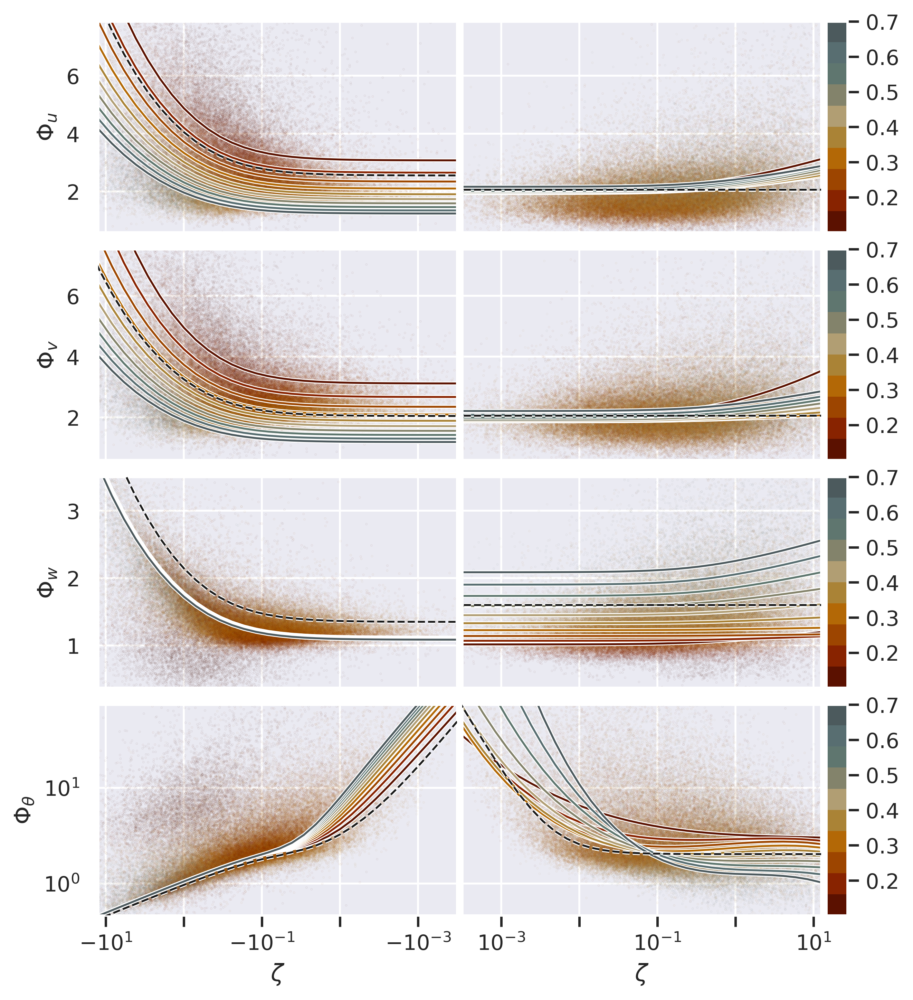

In [68]:
sz=1.4
fig,axs=plt.subplots(4,3,figsize=(5*sz,6*sz),gridspec_kw={'width_ratios': [1,1,.06]})
ss=.03
alph=.1
minpct=1e-05

anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

j=0
for v in ['U','V','W','T']:
    # SETUP
    cc=cani_norm(d_unst[v]['ani'][:])
    cc_s=cani_norm(d_stbl[v]['ani'][:])
    phi=d_unst[v]['phi']
    phi_s=d_stbl[v]['phi']
    
    ymin=min(np.nanpercentile(phi,.1),np.nanpercentile(phi_s,.1))
    ymax=max(np.nanpercentile(phi,99),np.nanpercentile(phi_s,99))
    
    ##### UNSTABLE #####
    # SCATTER UNSTABLE
    axs[j,0].scatter(-d_unst[v]['zL'][:],phi,color=cc,s=ss,alpha=alph)
    
    # LINES UNSTABLE
    xplt=zL_u
    yplt=ust_stp[j]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W']:
            axs[j,0].semilogx(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,0].loglog(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=ust_old[j][0]
    if v in ['U','V','W']:
        axs[j,0].semilogx(-zL_u,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,0].loglog(-zL_u,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    if j==3:
        axs[j,0].tick_params(which="both", bottom=True)
        axs[j,0].set_xlabel(r'$\zeta$')
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,0].xaxis.set_minor_locator(locmin)
        axs[j,0].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    else:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    #axs[j,0].xaxis.set_minor_locator(tck.AutoMinorLocator())
    axs[j,0].set_ylabel(ylabels[j])
    axs[j,0].set_ylim(ymin,ymax)
    axs[j,0].invert_xaxis()
    
    ##### STABLE #####
    # SCATTER STABLE
    axs[j,1].scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
    
    # LINES STABLE
    xplt=zL_s
    yplt=stb_stp[j]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W']:
            axs[j,1].semilogx(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,1].loglog(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=stb_old[j][0]
    if v in ['U','V','W']:
        axs[j,1].semilogx(zL_s,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,1].loglog(zL_s,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    if j==3:
        axs[j,1].tick_params(which="both", bottom=True)
        axs[j,1].set_xlabel(r'$\zeta$')
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$10^{-3}$','',r'$10^{-1}$','',r'$10^{1}$'])
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    else:
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    axs[j,1].tick_params(labelleft=False)
    #axs[j,1].grid(False)
    #axs[j,1].xaxis.grid(True, which='minor')
    axs[j,1].set_ylim(ymin,ymax)
    
    
    #### COLORBAR ####
    axs[j,2].imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
    axs[j,2].set_xticks([],[])
    inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
    inta.extend(anilvl)
    inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
    xtc=np.interp([.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
    axs[j,2].set_yticks(xtc,[.2,.3,.4,.5,.6,.7])
    axs[j,2].grid(False)
    #plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
    axs[j,2].yaxis.tick_right()
    
    j=j+1
    
#fig.text(0.5, 0.04, r'$\zeta$', ha='center')
plt.subplots_adjust(hspace=.08,wspace=.02)
plt.savefig('images/img_4.png', bbox_inches = "tight")

# STP Performance 

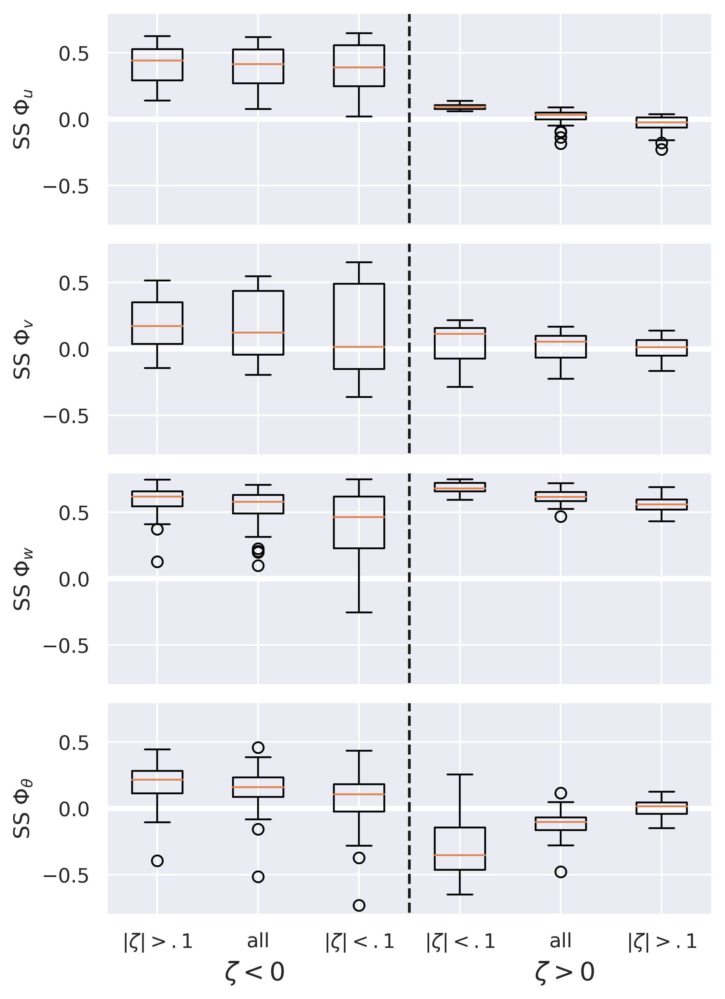

In [69]:
sz=1
j=0
fig,axs=plt.subplots(4,1,figsize=(6*sz,9*sz))
names=[r'$|\zeta|>.1$','all',r'$|\zeta|<.1$',r'$|\zeta|<.1$','all',r'$|\zeta|>.1$']
ylabels=[r'SS $\Phi_{u}$',r'SS $\Phi_{v}$',r'SS $\Phi_{w}$',r'SS $\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

for v in list(d_unst.keys())[0:4]:
    ss=[]
    ss.append(list(d_unst[v]['SShi_s'].values()))
    ss.append(list(d_unst[v]['SS_s'].values()))
    ss.append(list(d_unst[v]['SSlo_s'].values()))
    
    ss.append(list(d_stbl[v]['SSlo_s'].values()))
    ss.append(list(d_stbl[v]['SS_s'].values()))
    ss.append(list(d_stbl[v]['SShi_s'].values()))
    
    ss=np.array(ss)
    axs[j].plot([0,7],[0,0],color='w',linewidth=3)
    axs[j].boxplot(ss.T,labels=names)
    axs[j].plot([3.5,3.5],[-1,1],'k--')
    if j<3:
        axs[j].set_xticks([1,2,3,4,5,6],[])
    else:
        axs[j].set_xlabel(r'$\zeta<0$                               $\zeta>0$',fontsize=14)
    axs[j].set_ylabel(ylabels[j])
    axs[j].set_ylim(-.8,.8)
    axs[j].set_xlim(.5,6.5)
    #axs[j].tick_params(axis='x',labelrotation=45)
    j=j+1
    
plt.subplots_adjust(hspace=.08,wspace=.02)
plt.savefig('images/img_5.png', bbox_inches = "tight")

# New Fit Lines

In [7]:
d_unst2=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_unst_tw_v2.p','rb'))
d_stbl2=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_stbl_tw_v2.p','rb'))
#d_fixhc=pickle.load(open('/home/tsw35/soteria/neon_advanced/data/d_unst_twhc_v0.p','rb'))
#d_unst2['H2O']=d_fixhc['H2O']
#d_unst2['CO2']=d_fixhc['CO2']

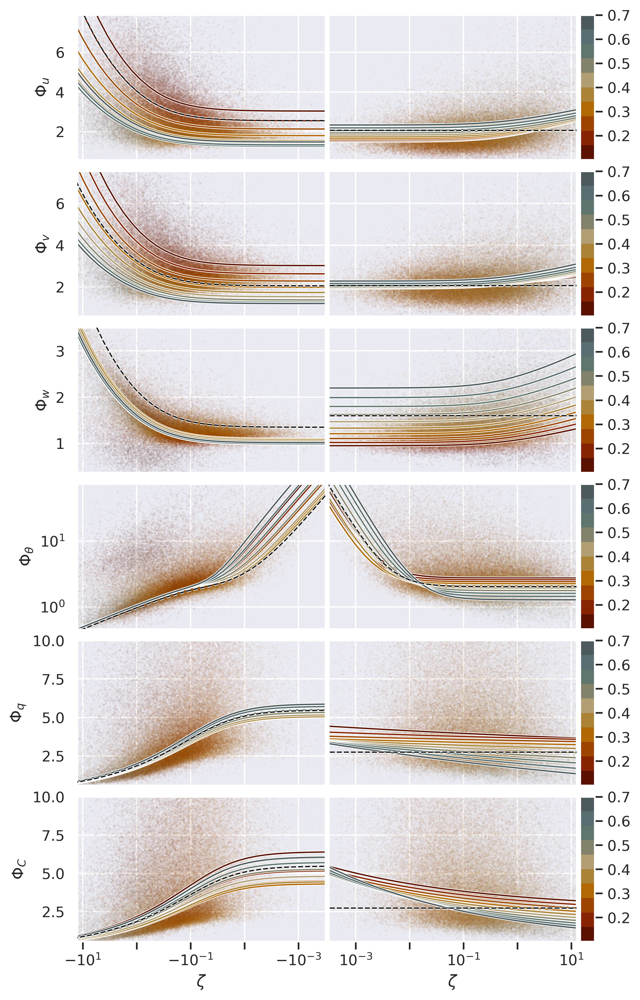

In [11]:
sz=1.4
fig,axs=plt.subplots(6,3,figsize=(5*sz,9*sz),gridspec_kw={'width_ratios': [1,1,.06]})
ss=.03
alph=.1
minpct=1e-05

anibins=np.linspace(vmn_a,vmx_a,11)
anilvl=(anibins[0:-1]+anibins[1:])/2
anic=cani_norm(anilvl)
ylabels=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

j=0
for v in ['U','V','W','T','H2O','CO2']:
    # SETUP
    cc=cani_norm(d_unst[v]['ani'][:])
    cc_s=cani_norm(d_stbl[v]['ani'][:])
    phi=d_unst[v]['phi']
    phi_s=d_stbl[v]['phi']
    
    ymin=min(np.nanpercentile(phi,.1),np.nanpercentile(phi_s,.1))
    ymax=max(np.nanpercentile(phi,99),np.nanpercentile(phi_s,99))
    if v in ['H2O','CO2']:
        ymax=10
    ##### UNSTABLE #####
    # SCATTER UNSTABLE
    axs[j,0].scatter(-d_unst[v]['zL'][:],phi,color=cc,s=ss,alpha=alph)
    
    # LINES UNSTABLE
    xplt=d_unst2[v]['p_zL'][:]
    yplt=d_unst2[v]['p_phi'][:]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,0].semilogx(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,0].loglog(-xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=ust_old[j][0]
    if v in ['U','V','W','H2O','CO2']:
        axs[j,0].semilogx(-zL_u,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,0].loglog(-zL_u,yplt,'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    if j==5:
        axs[j,0].tick_params(which="both", bottom=True)
        axs[j,0].set_xlabel(r'$\zeta$')
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,0].xaxis.set_minor_locator(locmin)
        axs[j,0].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$-10^{-3}$','',r'$-10^{-1}$','',r'$-10^{1}$'])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    else:
        axs[j,0].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,0].set_xlim(10**(-3.5),10**(1.1))
    #axs[j,0].xaxis.set_minor_locator(tck.AutoMinorLocator())
    axs[j,0].set_ylabel(ylabels[j])
    axs[j,0].set_ylim(ymin,ymax)
    axs[j,0].invert_xaxis()
    
    ##### STABLE #####
    # SCATTER STABLE
    axs[j,1].scatter(d_stbl[v]['zL'][:],phi_s,color=cc_s,s=ss,alpha=alph)
    
    # LINES STABLE
    xplt=d_stbl2[v]['p_zL'][:]
    yplt=d_stbl2[v]['p_phi'][:]
    for i in range(yplt.shape[0]):
        if v in ['U','V','W','H2O','CO2']:
            axs[j,1].semilogx(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
        else:
            axs[j,1].loglog(xplt,yplt[i,:],color=anic[i],linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()])
    yplt=stb_old[j][0]
    if v in ['U','V','W','H2O','CO2']:
        axs[j,1].semilogx(zL_s,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)
    else:
        axs[j,1].loglog(zL_s,yplt[:],'--',color='k',linewidth=1,path_effects=[pe.Stroke(linewidth=2, foreground='w'), pe.Normal()],zorder=5)

    
    # LABELING
    if j==5:
        axs[j,1].tick_params(which="both", bottom=True)
        axs[j,1].set_xlabel(r'$\zeta$')
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[r'$10^{-3}$','',r'$10^{-1}$','',r'$10^{1}$'])
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    else:
        locmin = matplotlib.ticker.LogLocator(base=10.0, subs=(0.1,0.2,0.4,0.6,0.8,1,2,4,6,8,10 )) 
        axs[j,1].xaxis.set_minor_locator(locmin)
        axs[j,1].xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        axs[j,1].set_xticks([10**-3,10**-2,10**-1,1,10],[])
        axs[j,1].set_xlim(10**(-3.5),10**(1.1))
    axs[j,1].tick_params(labelleft=False)
    #axs[j,1].grid(False)
    #axs[j,1].xaxis.grid(True, which='minor')
    axs[j,1].set_ylim(ymin,ymax)
    
    
    #### COLORBAR ####
    axs[j,2].imshow(anic.reshape(10,1,4),origin='lower',interpolation=None)
    axs[j,2].set_xticks([],[])
    inta=[anilvl[0]-(anilvl[1]-anilvl[0])]
    inta.extend(anilvl)
    inta.extend([anilvl[-1]+(anilvl[1]-anilvl[0])])
    xtc=np.interp([.2,.3,.4,.5,.6,.7],inta,np.linspace(-1,10,12))
    axs[j,2].set_yticks(xtc,[.2,.3,.4,.5,.6,.7])
    axs[j,2].grid(False)
    #plt.yticks([.2,.3,.4,.5,.6,.7]),[.2,.3,.4,.5,.6,.7])
    axs[j,2].yaxis.tick_right()
    
    j=j+1
    
#fig.text(0.5, 0.04, r'$\zeta$', ha='center')
plt.subplots_adjust(hspace=.08,wspace=.02)
plt.savefig('images/img_6_2.png', bbox_inches = "tight")

2.74

# New Performance

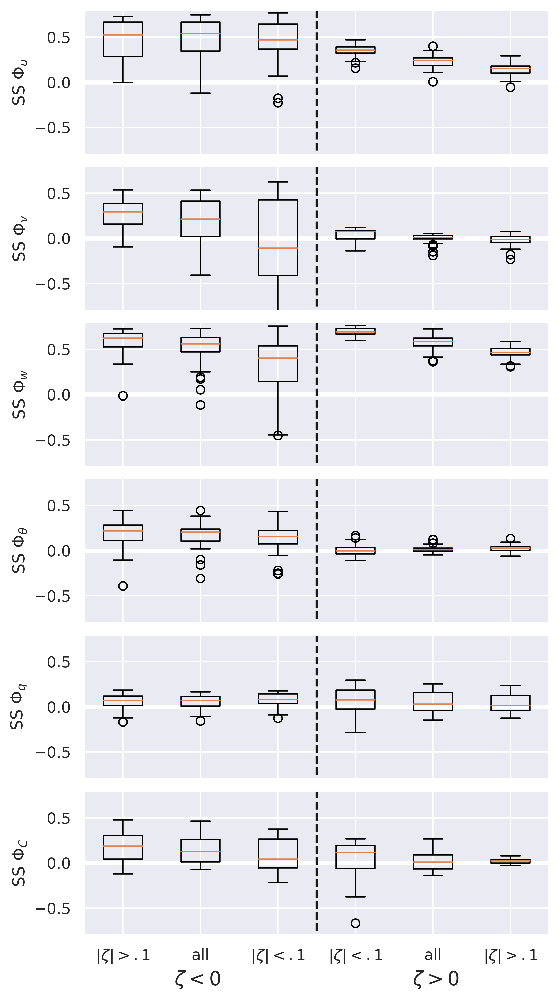

In [12]:
sz=1
j=0
fig,axs=plt.subplots(6,1,figsize=(6*sz,12*sz))
names=[r'$|\zeta|>.1$','all',r'$|\zeta|<.1$',r'$|\zeta|<.1$','all',r'$|\zeta|>.1$']
ylabels=[r'SS $\Phi_{u}$',r'SS $\Phi_{v}$',r'SS $\Phi_{w}$',r'SS $\Phi_{\theta}$',r'SS $\Phi_{q}$',r'SS $\Phi_{C}$']

for v in list(d_unst2.keys()):
    ss=[]
    ss.append(list(d_unst2[v]['SShi_s'].values()))
    ss.append(list(d_unst2[v]['SS_s'].values()))
    ss.append(list(d_unst2[v]['SSlo_s'].values()))
    
    ss.append(list(d_stbl2[v]['SSlo_s'].values()))
    ss.append(list(d_stbl2[v]['SS_s'].values()))
    ss.append(list(d_stbl2[v]['SShi_s'].values()))
    
    ss=np.array(ss)
    axs[j].plot([0,7],[0,0],color='w',linewidth=3)
    axs[j].boxplot(ss.T,labels=names)
    axs[j].plot([3.5,3.5],[-1,1],'k--')
    if j<5:
        axs[j].set_xticks([1,2,3,4,5,6],[])
    else:
        axs[j].set_xlabel(r'$\zeta<0$                               $\zeta>0$',fontsize=14)
    axs[j].set_ylabel(ylabels[j])
    axs[j].set_ylim(-.8,.8)
    axs[j].set_xlim(.5,6.5)
    #axs[j].tick_params(axis='x',labelrotation=45)
    j=j+1
    
plt.subplots_adjust(hspace=.08,wspace=.02)
plt.savefig('images/img_7_2.png', bbox_inches = "tight")

# Performance Heatmap

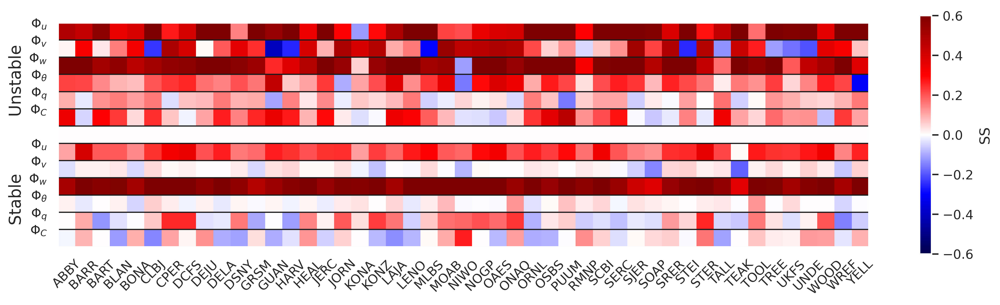

In [13]:
data=np.zeros((47,13))
a=1.2
_, ax = plt.subplots(figsize=(13*a,4*a),dpi=400)
sites=list(d_unst2[v]['SShi_s'].keys())
sites.sort()
var_=list(d_unst2.keys())
for i in range(len(sites)):
    site=sites[i]
    for j in range(6):
        v=var_[j]
        data[i,j]=d_unst2[v]['SS_s'][site]
        data[i,j+7]=d_stbl2[v]['SS_s'][site]

names=[r'$\Phi_{u}$',r'$\Phi_{v}$',r'$\Phi_{w}$',r'$\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

data2=data.T[:]
#for i in range(data2.shape[0]):
#    data2[i,:]=data2[i,:]-np.nanmean(data2[i,:])
        
plt.imshow(data2,cmap='seismic',vmin=-.6,vmax=.6)
plt.xticks(np.linspace(0,46,47),sites,rotation=45)
nm=[]
nm.extend(names)
nm.append('')
nm.extend(names)
nm.append('')
plt.yticks([-.5,.5,1.5,2.5,3.5,4.5,5.5,6.5,7.5,8.5,9.5,10.5,11.5,12.5],nm)
plt.ylabel('       Stable           Unstable       ',fontsize=14)
plt.grid(False,axis='x')
plt.grid(True,axis='y',color='k',linewidth=1)
plt.colorbar(shrink=.77,label=r'SS')
plt.savefig('images/img_8_2.png', bbox_inches = "tight")

# Delta Performance

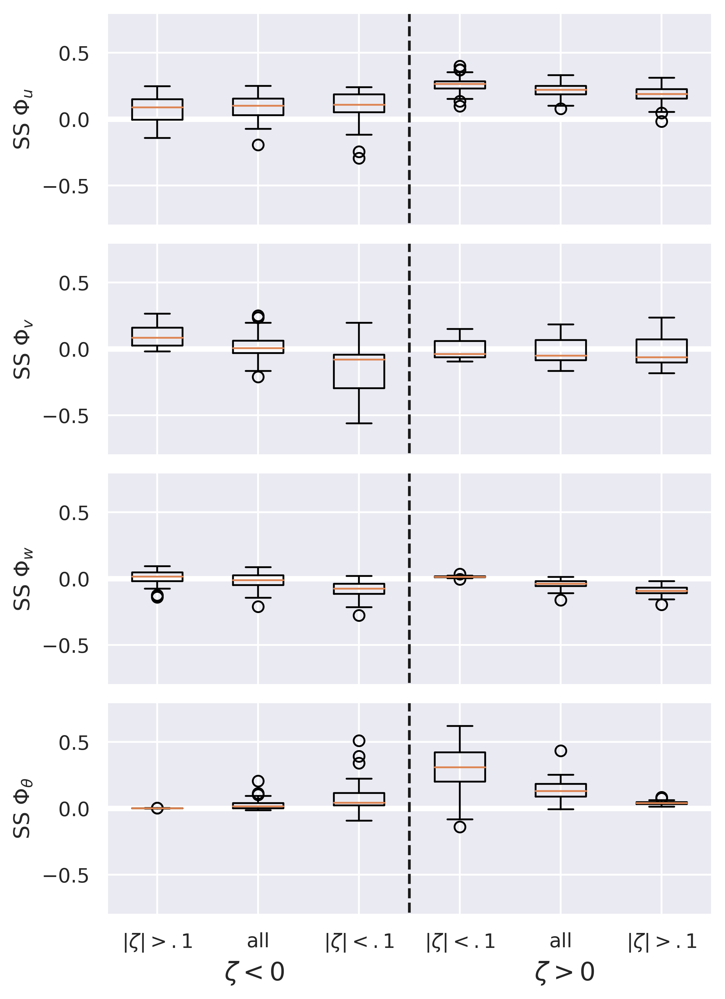

In [22]:
sz=1
j=0
fig,axs=plt.subplots(4,1,figsize=(6*sz,9*sz))
names=[r'$|\zeta|>.1$','all',r'$|\zeta|<.1$',r'$|\zeta|<.1$','all',r'$|\zeta|>.1$']
ylabels=[r'SS $\Phi_{u}$',r'SS $\Phi_{v}$',r'SS $\Phi_{w}$',r'SS $\Phi_{\theta}$',r'$\Phi_{q}$',r'$\Phi_{C}$']

for v in list(d_unst.keys())[0:4]:
    ss=[]
    ss.append(list(d_unst[v]['SShi_s'].values()))
    ss.append(list(d_unst[v]['SS_s'].values()))
    ss.append(list(d_unst[v]['SSlo_s'].values()))
    
    ss.append(list(d_stbl[v]['SSlo_s'].values()))
    ss.append(list(d_stbl[v]['SS_s'].values()))
    ss.append(list(d_stbl[v]['SShi_s'].values()))
    
    ss2=[]
    ss2.append(list(d_unst2[v]['SShi_s'].values()))
    ss2.append(list(d_unst2[v]['SS_s'].values()))
    ss2.append(list(d_unst2[v]['SSlo_s'].values()))
    
    ss2.append(list(d_stbl2[v]['SSlo_s'].values()))
    ss2.append(list(d_stbl2[v]['SS_s'].values()))
    ss2.append(list(d_stbl2[v]['SShi_s'].values()))
    
    ss=np.array(ss)
    ss2=np.array(ss2)
    ss=ss2-ss
    axs[j].plot([0,7],[0,0],color='w',linewidth=3)
    axs[j].boxplot(ss.T,labels=names)
    axs[j].plot([3.5,3.5],[-1,1],'k--')
    if j<3:
        axs[j].set_xticks([1,2,3,4,5,6],[])
    else:
        axs[j].set_xlabel(r'$\zeta<0$                               $\zeta>0$',fontsize=14)
    axs[j].set_ylabel(ylabels[j])
    axs[j].set_ylim(-.8,.8)
    axs[j].set_xlim(.5,6.5)
    #axs[j].tick_params(axis='x',labelrotation=45)
    j=j+1
    
plt.subplots_adjust(hspace=.08,wspace=.02)
#plt.savefig('images/img_5.png', bbox_inches = "tight")